In [7]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import linkage, dendrogram
import networkx as nx
import plotly.graph_objects as go

import seaborn as sns
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
from sklearn.manifold import MDS
from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.spatial.distance import pdist, squareform
from mpl_toolkits.mplot3d import Axes3D
import networkx as nx
import plotly.io as pio

In [8]:
#xlsx_path = './240906_이연희교수님_correlation_data.xlsx'
xlsx_path = './Data/20240909 시각화 작업 정리.xlsx'

In [10]:
df = pd.read_excel(xlsx_path).dropna()
df.columns

Index(['Age', 'VAS', 'DJD_DCTMD', 'Female', 'Symptom Duration', 'CMO', 'MMO',
       'CMI', 'TMJ Noise', 'TMJ Pain', 'Muscle Pain', 'LMO', 'Bruxism',
       'Tinnitus', 'Headache', 'No of Chief Complaints ', 'Myalgia_DCTMD',
       'Local Myagia_DCTMD', 'Myofascial Pain_DCTMD',
       'Myofascial Pain With Referral_DCTMD', 'DD_With Reduction_DCTMD',
       'DD With Intermittent Locking_DCTMD',
       'DD Wo Reduction With Limited Opening_DCTMD',
       'DD Wo Reduction Wo Limited Opening_DCTMD', 'Arthralgia_DCTMD',
       'HATMD_DCTMD', 'Subluxation_DCTMD', 'No of Diagnoses'],
      dtype='object')

In [11]:
df.rename(columns={'Acute0Chronic1': 'Chronic TMD', 'STOP-Bang 3': 'STOP-Bang>=3', 'STOP-Bang 5': 'STOP-Bang>=5', 'SEX_M1F2' : 'Female'}, inplace=True)
df

,Age,VAS,DJD_DCTMD,Female,Symptom Duration,CMO,MMO,CMI,TMJ Noise,TMJ Pain,...,Myofascial Pain_DCTMD,Myofascial Pain With Referral_DCTMD,DD_With Reduction_DCTMD,DD With Intermittent Locking_DCTMD,DD Wo Reduction With Limited Opening_DCTMD,DD Wo Reduction Wo Limited Opening_DCTMD,Arthralgia_DCTMD,HATMD_DCTMD,Subluxation_DCTMD,No of Diagnoses
0,19,0.0,1,2,12,38.0,40.0,0.1000,1,0,...,0,0,1,1,0,0,0,0,0,3
1,19,5.0,0,1,0,15.0,41.0,0.0625,0,1,...,0,0,0,0,0,0,0,1,0,3
2,19,0.0,0,1,36,25.0,40.0,0.0500,0,0,...,0,0,0,0,1,1,0,0,0,2
3,19,3.0,0,1,0,50.0,60.0,0.0625,0,1,...,1,0,0,0,0,0,0,0,1,4
4,19,6.0,1,2,1,32.0,41.0,0.1000,0,1,...,0,0,1,0,0,1,1,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4656,24,0.0,0,1,12,0.0,0.0,0.0000,1,0,...,0,0,1,0,0,0,0,0,0,1
4657,22,8.0,0,2,54,40.0,45.0,0.0625,1,1,...,0,0,0,0,0,0,0,0,0,0
4658,17,7.0,1,1,1,19.0,40.0,0.3625,1,1,...,0,0,1,1,1,1,1,0,0,7
4659,16,6.0,0,2,7,45.0,50.0,0.3500,1,1,...,1,1,0,0,0,0,0,1,1,6


In [16]:
def plot_clustering_graph(df, target_column, center_color = 'orange', save_path=''):
    # 상관행렬 계산
    corr_matrix = df.corr()
    
    # 그래프 생성
    G = nx.Graph()
    
    # 노드 추가 (모든 변수 추가)
    for col in corr_matrix.columns:
        G.add_node(col)
    
    # 중심 변수와 다른 변수들 간의 상관관계를 엣지로 추가
    for col in corr_matrix.columns:
        if col != target_column:
            weight = corr_matrix[target_column][col]
            G.add_edge(target_column, col, weight=abs(weight))
    
    # 모든 변수들 간의 상관관계 엣지 추가 (중심 노드와 다른 변수들만 추가)
    for col1 in corr_matrix.columns:
        if col1 != target_column:
            weight = corr_matrix[target_column][col1]
            if abs(weight) > 0.01:  # 상관계수의 절대값이 특정 임계값 이상일 때만 간선 추가
                G.add_edge(target_column, col1, weight=abs(weight))
    
    # 노드 위치 설정 (기본 Force-Directed 배치 사용)
    pos = nx.spring_layout(G, k=0.3, seed=42)
    
    # 중심 노드의 위치를 기준으로 모든 다른 노드의 위치 조정
    if target_column in pos:
        for node in pos:
            if node != target_column:
                pos[node] = pos[node] * 0.8 + pos[target_column] * 0.2

    # 노드 크기 설정 (기준 변수와의 상관계수에 선형 변환 적용)
    node_sizes = []
    min_weight = 0.01
    max_weight = 0.3
    for node in G.nodes():
        if node == target_column:
            node_sizes.append(3000)  # 중심 변수는 더 큰 크기로 설정
        else:
            weight = corr_matrix[target_column][node]
            # 선형 변환 공식: size = (weight - min_weight) / (max_weight - min_weight)
            # 최소 크기 200, 최대 크기 1000으로 설정
            size = 200 + ((abs(weight) - min_weight) / (max_weight - min_weight)) * (1000 - 200)
            node_sizes.append(size)

    # 중심 노드의 색상 조건
    #center_color = 'orange' 
    #if target_column == 'Chronic TMD ' : center_color = 'red'
    #if target_column == 'VAS-I' : center_color = 'orange'
    #if target_column == 'Treatment duration ' : center_color = 'green' 
        
    # 노드 색상 설정 (중심 노드는 조건에 따라, 나머지는 쨍한 하늘색)
    node_colors = [center_color if node == target_column else 'deepskyblue' for node in G.nodes()]
    
    # 간선 두께 설정 (상관계수에 선형 변환 적용)
    edges = [(u, v, d) for u, v, d in G.edges(data=True) if u == target_column or v == target_column]  # 중심 노드와 연결된 간선만
    edge_widths = [1 + ((d['weight'] - min_weight) / (max_weight - min_weight)) * (6 - 1) for u, v, d in edges]  # 최소 두께 1, 최대 두께 6

    # 간선 레이블 설정 (상관계수 표시)
    edge_labels = {(u, v): f"{d['weight']:.2f}" for u, v, d in edges if u == target_column or v == target_column}

    # 간선 레이블의 글자 크기 설정 (상관계수에 따라)
    edge_label_font_sizes = {(u, v): 8 + d['weight'] * 10 for u, v, d in edges}

    # 노드와 간선 그리기
    plt.figure(figsize=(20, 20), dpi=350)  # 그림 크기 확대
    
    # 노드 그리기
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes)
    
    # 간선 그리기 (중심 노드와 연결된 간선만)
    nx.draw_networkx_edges(
        G, pos, edgelist=[(u, v) for u, v, d in edges],
        width=edge_widths, edge_color='grey'
    )

    # 노드 라벨 추가
    # 중심 노드는 큰 폰트, 나머지 노드는 일반 폰트 크기로 설정
    for node in G.nodes():
        font_size = 16 if node == target_column else 14
        nx.draw_networkx_labels(G, pos, labels={node: node}, font_size=font_size, font_color='black')
    
    # 간선 레이블 추가 (중심 노드와 연결된 간선만, 상관계수에 따라 글자 크기 조정)
    for (u, v), label in edge_labels.items():
        font_size = edge_label_font_sizes[(u, v)]
        nx.draw_networkx_edge_labels(G, pos, edge_labels={(u, v): label}, font_size=font_size, font_color='black')

    # 제목 설정
    plt.title(f'Clustering Graph of Correlations with {target_column}', fontsize=20)
    plt.axis('off')  # 축 숨기기
    plt.savefig(save_path)
    plt.show()


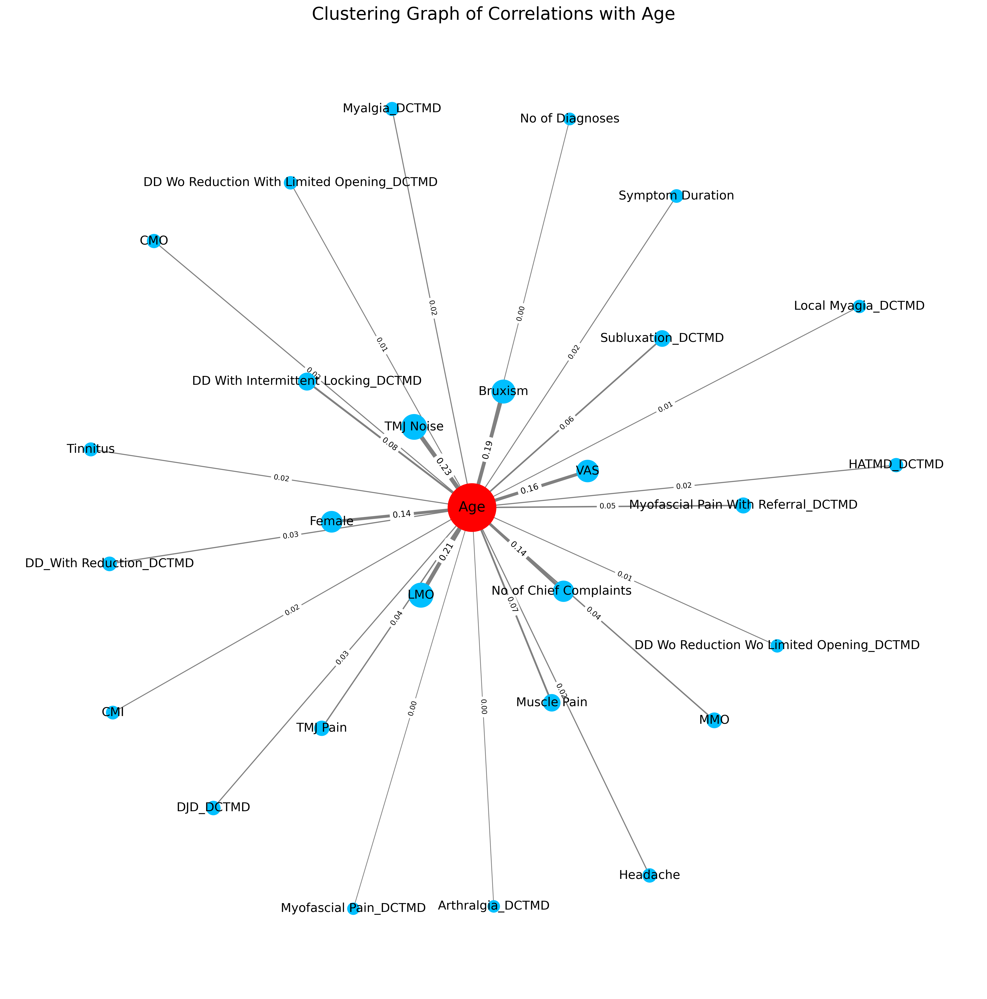

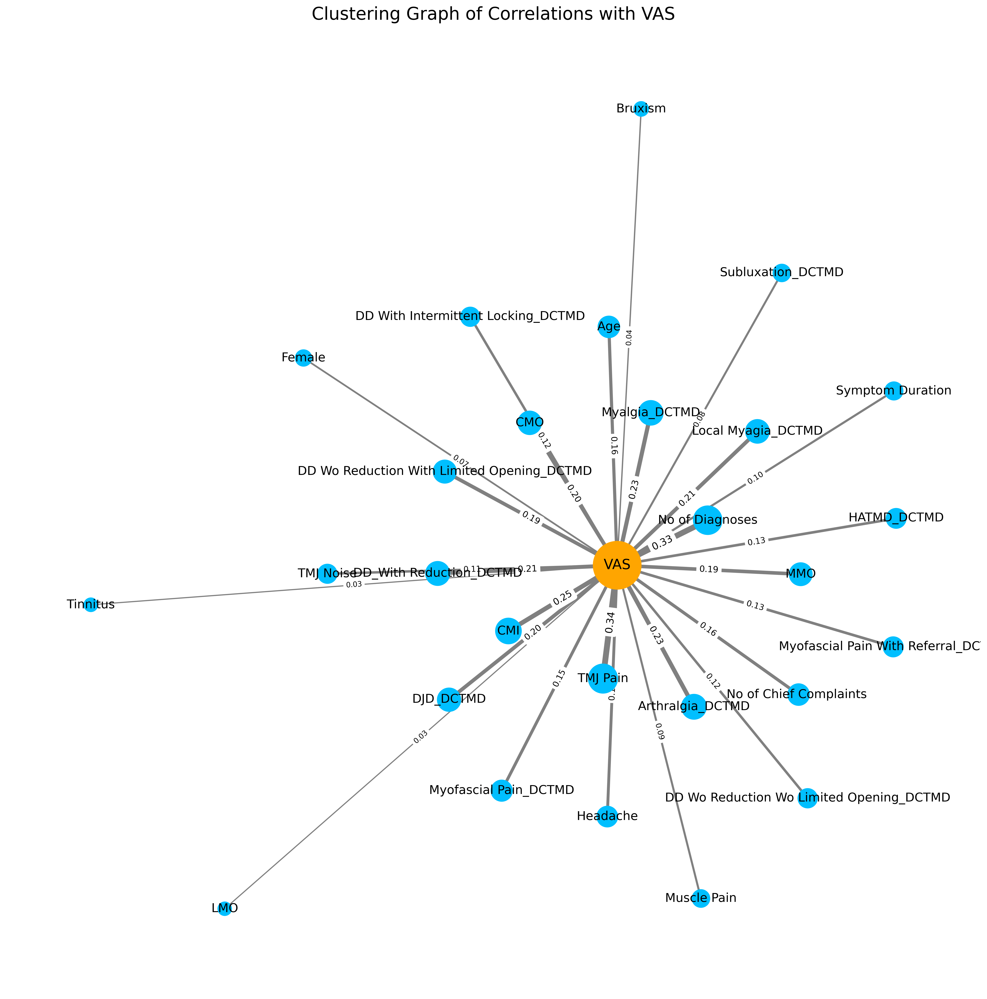

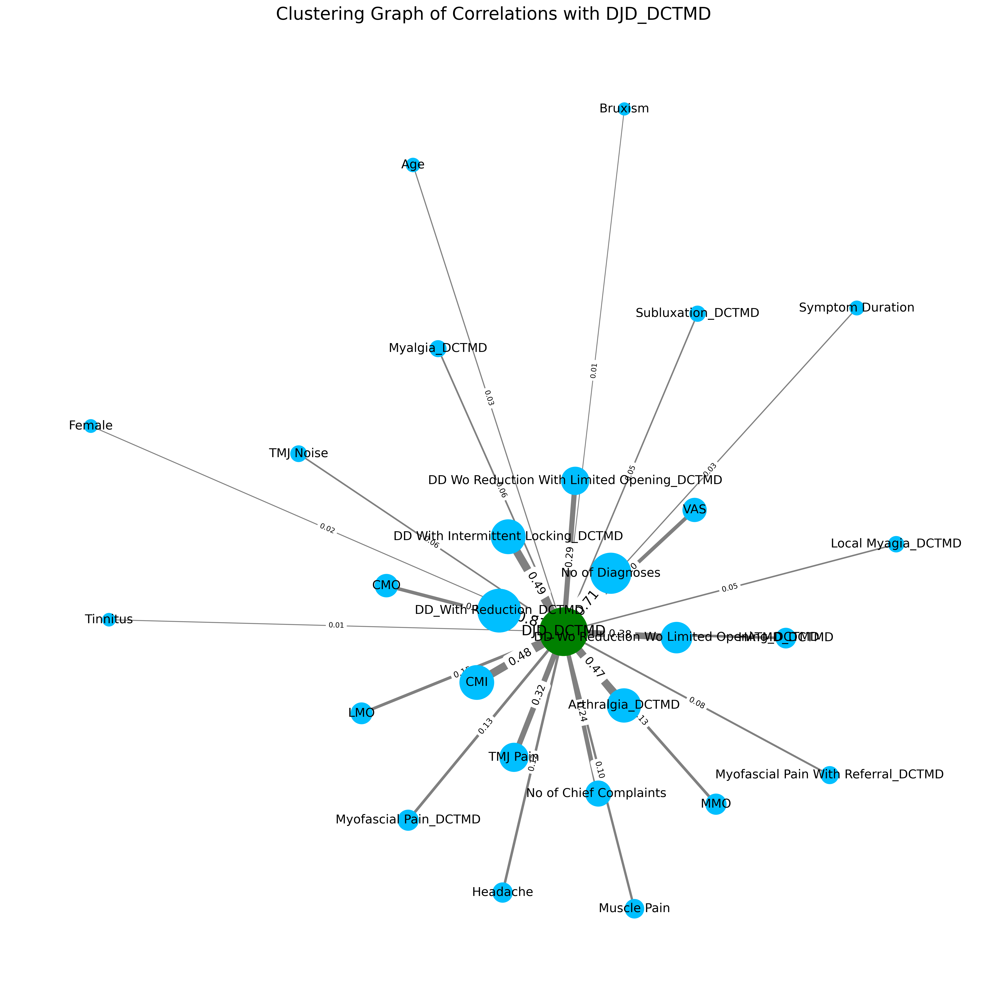

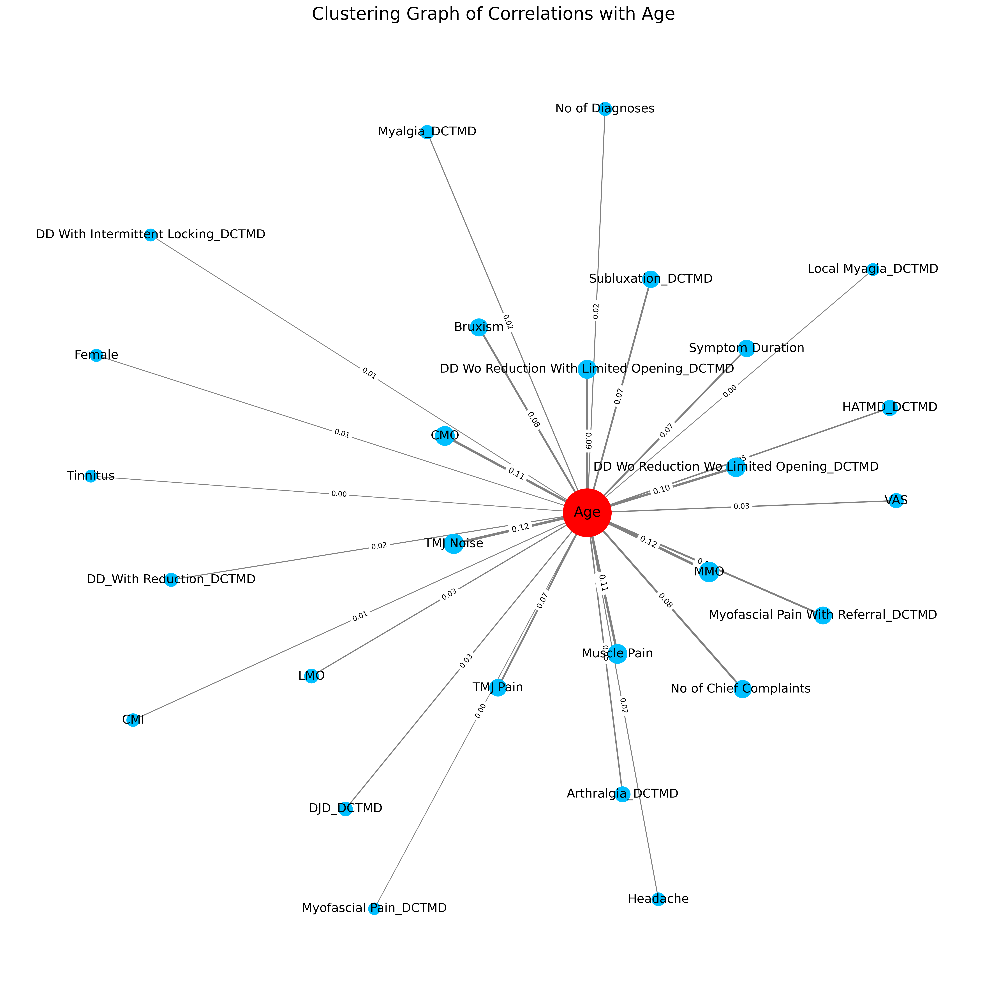

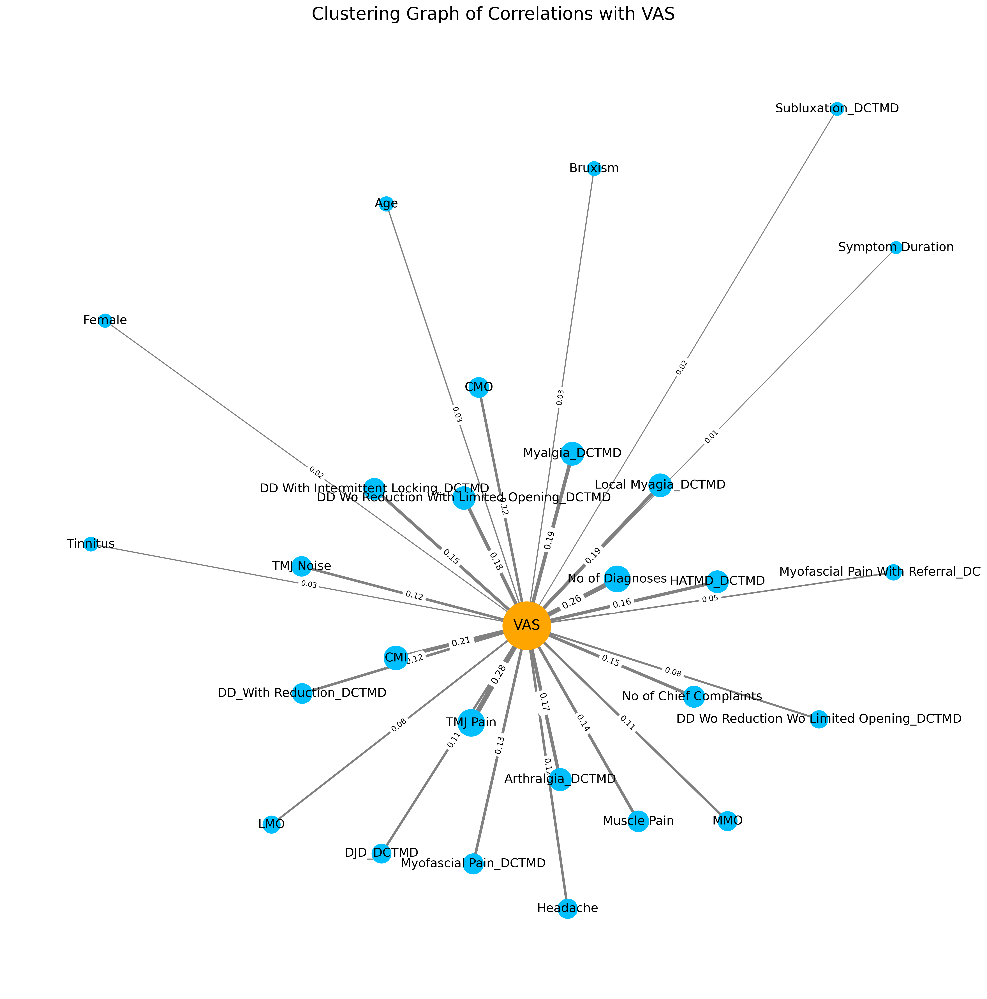

...

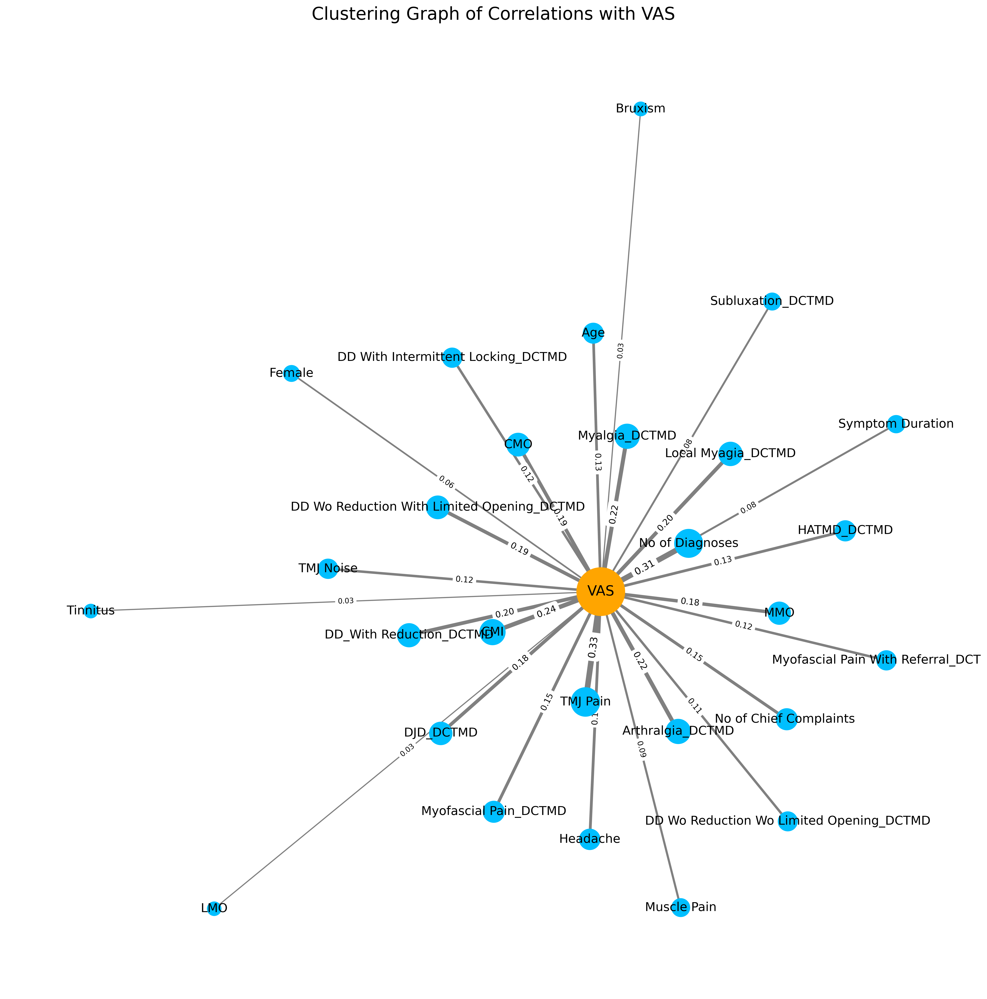

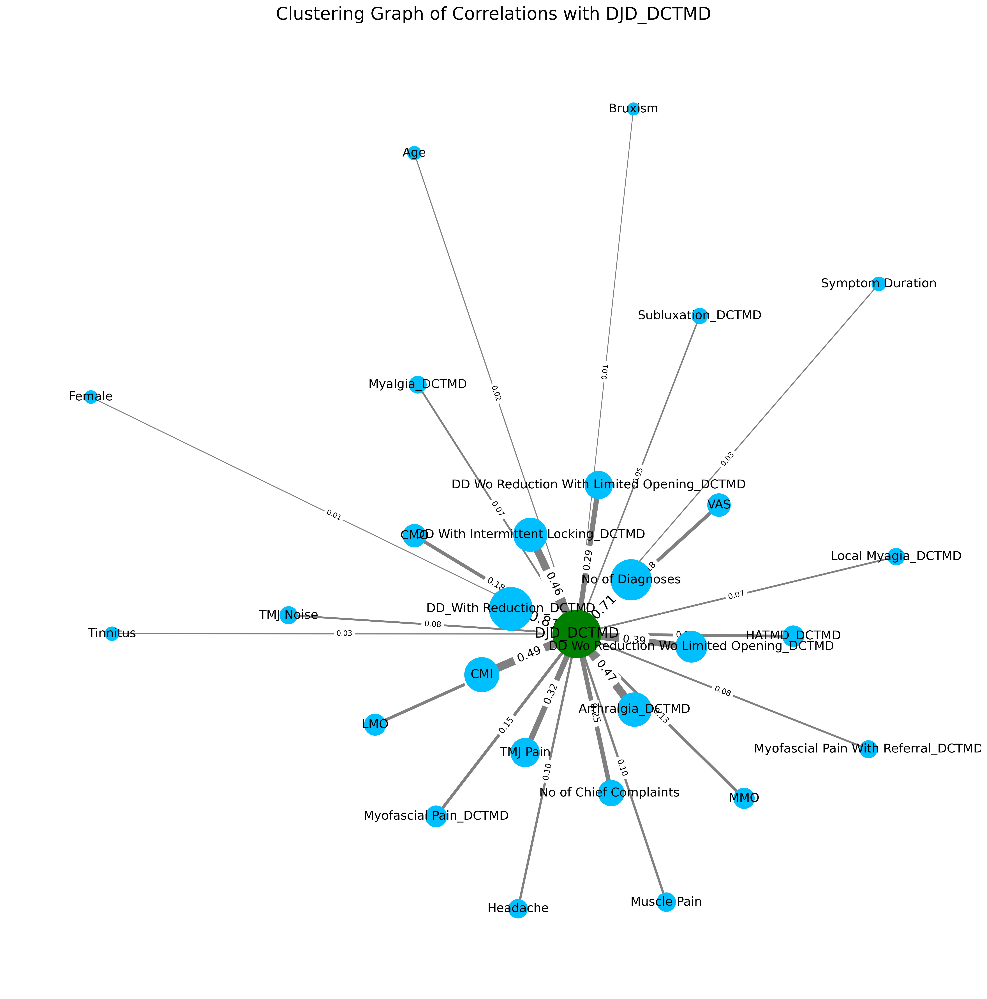

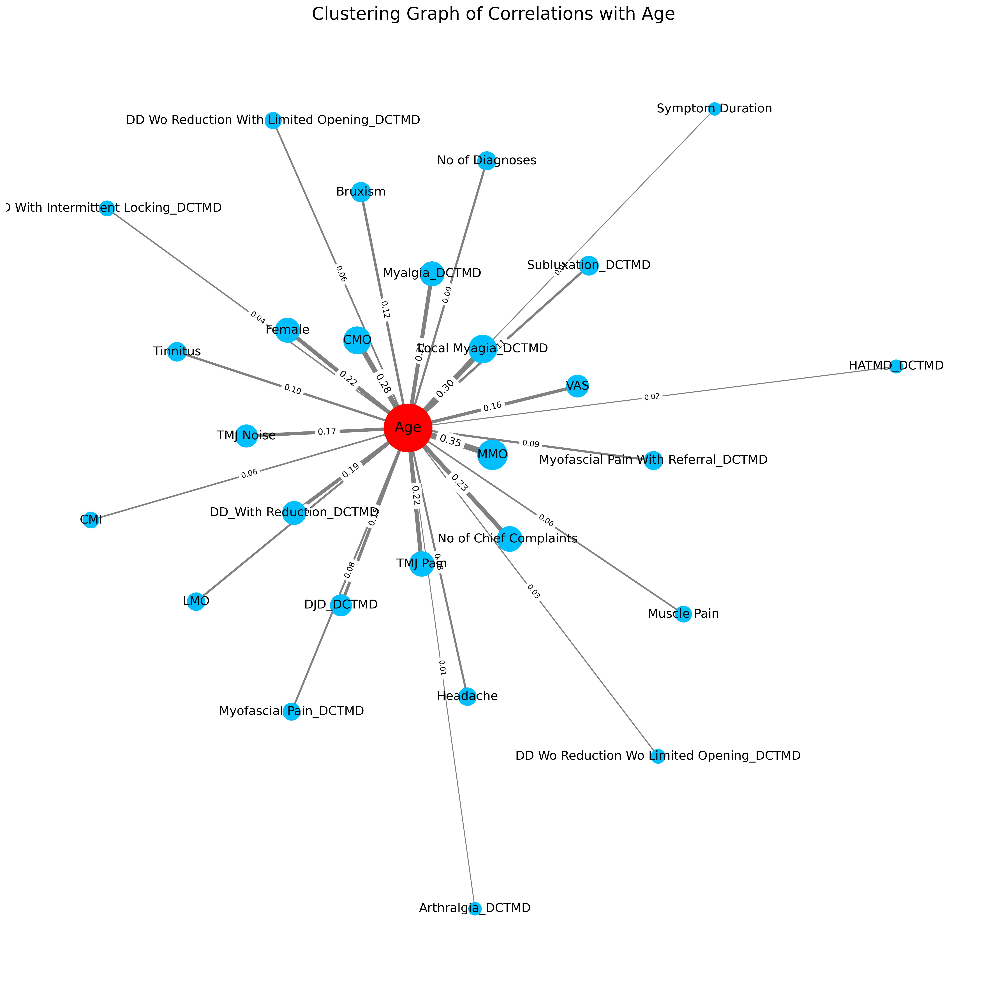

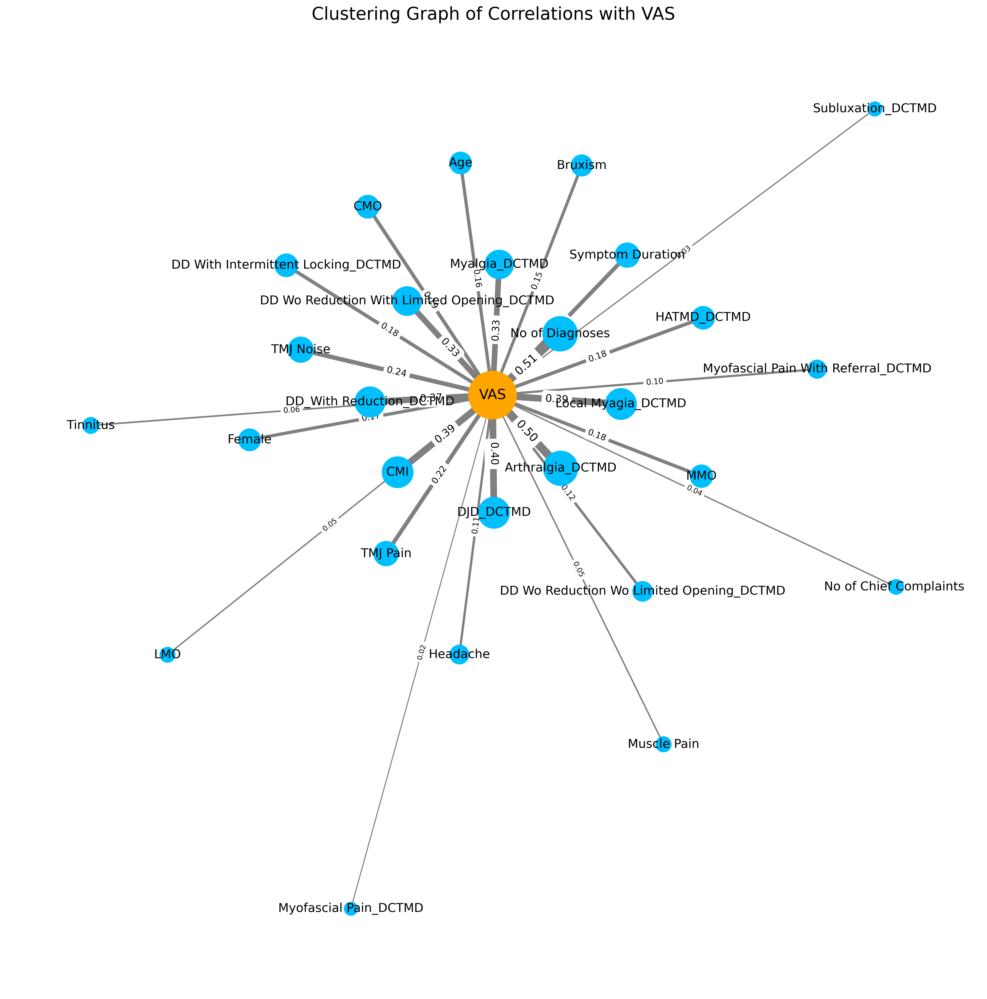

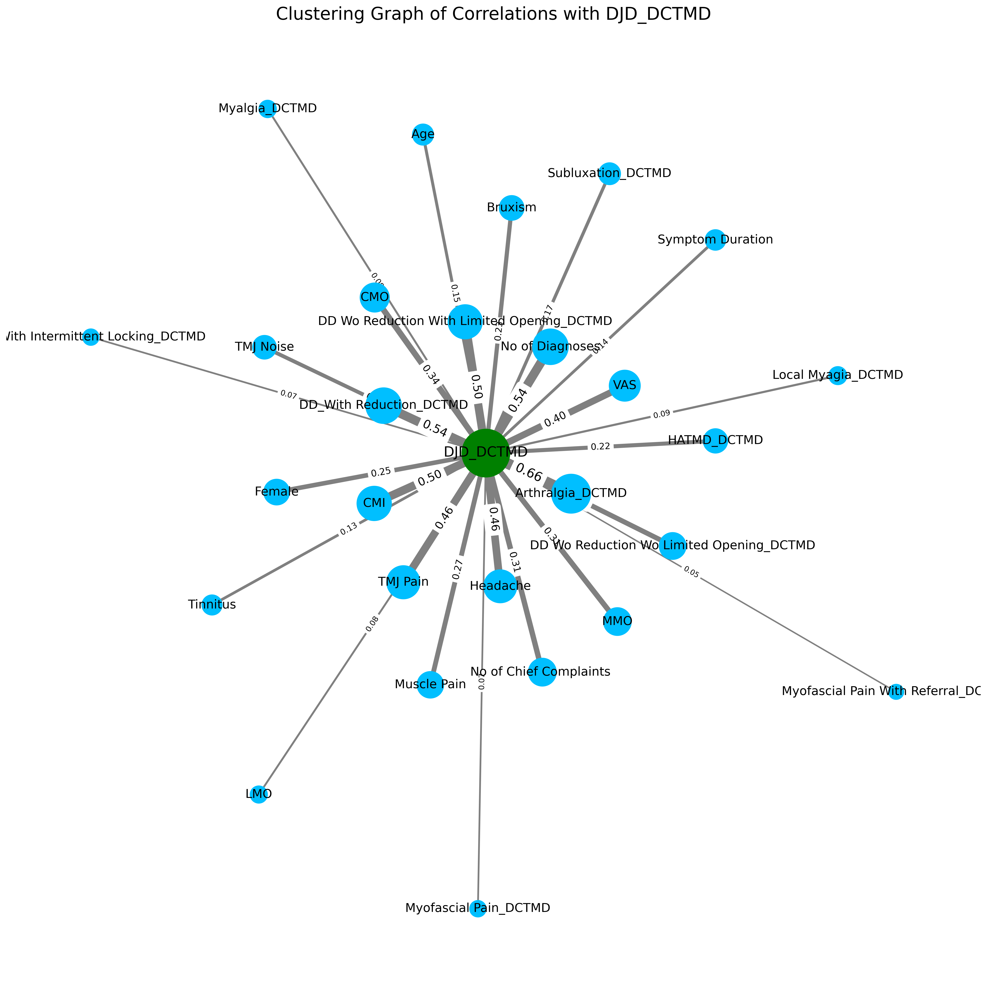

In [17]:
# Acute0Chronic1과 다른 모든 칼럼 간의 Force-Directed Graph

for i in range (4):
    
    if i == 0 : 
        filtered_df = df[df['Age']< 65]
        surfix = 'Age<65'
    if i == 1 : 
        filtered_df = df[df['Age']>= 65]
        surfix = 'Age>=65'
    if i == 2 : 
        filtered_df = df[df['Age']< 85]
        surfix = 'Age<85'
    if i == 3 : 
        filtered_df = df[df['Age']>= 85]
        surfix = 'Age>=85'
        
    target_column = 'Age'
    plot_clustering_graph(filtered_df, target_column, center_color = 'red', save_path = f'./Figure/3_{target_column}_{surfix}')

    target_column = 'VAS'
    plot_clustering_graph(filtered_df, target_column, center_color = 'orange', save_path = f'./Figure/3_{target_column}_{surfix}')

    target_column = 'DJD_DCTMD'
    plot_clustering_graph(filtered_df, target_column, center_color = 'green', save_path = f'./Figure/3_{target_column}_{surfix}')

In [20]:
def plot_3d_force_directed_correlation(df, target_column, central_node_color = 'orange', save_path=''):
    # Create graph
    G = nx.Graph()

    # Add nodes and edges with weights
    for col in df.columns:
        if col != target_column:
            correlation = df[target_column].corr(df[col])
            G.add_edge(target_column, col, weight=correlation)

    # Add edges between all surrounding nodes based on their correlations
    surrounding_nodes = [node for node in df.columns if node != target_column]
    for i in range(len(surrounding_nodes)):
        for j in range(i + 1, len(surrounding_nodes)):
            node1 = surrounding_nodes[i]
            node2 = surrounding_nodes[j]
            correlation = df[node1].corr(df[node2])
            G.add_edge(node1, node2, weight=correlation)

    # Get node positions in 3D with initial layout
    pos = nx.spring_layout(G, dim=3, seed=42, scale=2.0)  # Adjust scale for initial distance

    # Fine-tune node positions
    pos_adjusted = {node: (x * 1.5, y * 1.5, z * 1.5) for node, (x, y, z) in pos.items()}

    # Prepare edge traces and labels
    edge_traces = []
    for edge in G.edges(data=True):
        x_edges = [pos_adjusted[edge[0]][0], pos_adjusted[edge[1]][0]]
        y_edges = [pos_adjusted[edge[0]][1], pos_adjusted[edge[1]][1]]
        z_edges = [pos_adjusted[edge[0]][2], pos_adjusted[edge[1]][2]]

        edge_width = max(0.5, abs(edge[2]['weight']) * 10)  # Ensure width is not too small

        edge_trace = go.Scatter3d(
            x=x_edges, y=y_edges, z=z_edges,
            mode='lines',
            line=dict(color='grey', width=edge_width),
            hoverinfo='none'
        )
        edge_traces.append(edge_trace)

    # Prepare node trace
    x_nodes = [pos_adjusted[node][0] for node in G.nodes]
    y_nodes = [pos_adjusted[node][1] for node in G.nodes]
    z_nodes = [pos_adjusted[node][2] for node in G.nodes]

    node_sizes = [40 if node == target_column else 15 + (abs(G[target_column][node]['weight']) * 10) for node in G.nodes]
    node_text_sizes = [24 if node == target_column else 12 for node in G.nodes]

    # Define central node color based on the target column
    #central_node_color = 'red' if 'Chronic TMD' in target_column else 'orange' if 'VAS-I' in target_column else 'green' if 'Treatment duration' in target_column else 'red'

    node_trace = go.Scatter3d(
        x=x_nodes, y=y_nodes, z=z_nodes,
        mode='markers+text',
        marker=dict(
            size=node_sizes,
            color=[central_node_color if node == target_column else 'skyblue' for node in G.nodes],
            line=dict(width=2, color='DarkSlateGrey')
        ),
        text=[node if node != target_column else f"<b>{node}</b>" for node in G.nodes],
        textposition='top center',
        textfont=dict(size=node_text_sizes),
        hoverinfo='text'
    )

    # Create the figure
    fig = go.Figure(data=edge_traces + [node_trace])

    # Update layout to remove background color, axis, and grid and to increase figure size
    fig.update_layout(
        showlegend=False,
        scene=dict(
            xaxis=dict(showbackground=False, showgrid=False, showticklabels=False),
            yaxis=dict(showbackground=False, showgrid=False, showticklabels=False),
            zaxis=dict(showbackground=False, showgrid=False, showticklabels=False)
        ),
        margin=dict(l=0, r=0, b=0, t=0),
        width=1800,  # Increase figure width
        height=1200  # Increase figure height
    )

    # Save the figure as an HTML file
    pio.write_html(fig, save_path)

    fig.show()

In [22]:
# Acute0Chronic1과 다른 모든 칼럼 간의 Force-Directed Graph
for i in range (4):
    
    if i == 0 : 
        filtered_df = df[df['Age']< 65]
        surfix = 'Age<65'
    if i == 1 : 
        filtered_df = df[df['Age']>= 65]
        surfix = 'Age>=65'
    if i == 2 : 
        filtered_df = df[df['Age']< 85]
        surfix = 'Age<85'
    if i == 3 : 
        filtered_df = df[df['Age']>= 85]
        surfix = 'Age>=85'
        
    plot_3d_force_directed_correlation(filtered_df, 'Age', central_node_color = 'red', save_path = f"./Figure/3_Age_{surfix}_3d_force_directed_correlation.html")
    plot_3d_force_directed_correlation(filtered_df, 'VAS', central_node_color = 'orange', save_path = f"./Figure/3_VAS_{surfix}_3d_force_directed_correlation.html")
    plot_3d_force_directed_correlation(filtered_df, 'DJD_DCTMD', central_node_color = 'green', save_path = f"./Figure/3_DJD_DCTMD_{surfix}_3d_force_directed_correlation.html")